In [2]:
%run /home/dbaciur/NTU/NTU/notes/Constants.ipynb

Constants loaded


In this file we check example frames representing visual behaviors

In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import torch
import torchvision as tv
from torchvision.transforms import transforms

SEED = 1

## Import annotations

In [23]:
annotations_df = pd.read_csv(C.PROCESSED_ANNOTATIONS_PATH)
annotations_df.head(1)

,Id,Behavior,BehaviorId,Duration (s),Start (s),Stop (s),Video,Time
0,0,eye contact,0,2841.008,29.355,2870.363,PH1011-PHYSICS_20150922,1449.859


### Count annotations

In [8]:
events_count = {}
for beh in C.BEH_IDS.keys():
    beh_annotations = annotations_df[annotations_df[C.A_BEHAVIOR] == beh]
    events_count[beh] = len(beh_annotations)
# sort by value
events_count = dict(sorted(events_count.items(), key=lambda item: item[1], reverse=True))
events_count

{'eye contact': 9824,
 'Writing on slides': 6738,
 'Writing on a whiteboard': 2975,
 'P, Asking questions': 2882,
 'P, cHarts in slides': 2248,
 'P, giving questions to students: rhetorical, comprehension questions", point each question': 1998,
 'P, Images in slides': 1746,
 'S, Asking questions': 1730,
 'S, giving questions to students: rhetorical, comprehension questions': 1430,
 'Movement across podium': 1301,
 'S, cHarts in slides': 1078,
 'S, Images in slides': 914,
 'Active teacher stands by slides and explains them': 796,
 'P, organization: giving class outline, clearly indicating Transition from one topic to another"': 638,
 'P, Session on tests': 587,
 'S, organization: giving class outline, clearly indicating Transition from one topic to another': 492,
 'P, Films or animations in slides': 309,
 'Laughter': 293,
 'S, Session on tests': 267,
 'S, Films or animations in slides': 258,
 'demonstration': 251,
 'use of voice intonation to Emphasise more important issues/topics': 191

In [9]:
# output for Latex document
for (event, count) in events_count.items():
    print(str(count) + " & " + str(event) + " \\\\")

9824 & eye contact \\
6738 & Writing on slides \\
2975 & Writing on a whiteboard \\
2882 & P, Asking questions \\
2248 & P, cHarts in slides \\
1998 & P, giving questions to students: rhetorical, comprehension questions", point each question \\
1746 & P, Images in slides \\
1730 & S, Asking questions \\
1430 & S, giving questions to students: rhetorical, comprehension questions \\
1301 & Movement across podium \\
1078 & S, cHarts in slides \\
914 & S, Images in slides \\
796 & Active teacher stands by slides and explains them \\
638 & P, organization: giving class outline, clearly indicating Transition from one topic to another" \\
587 & P, Session on tests \\
492 & S, organization: giving class outline, clearly indicating Transition from one topic to another \\
309 & P, Films or animations in slides \\
293 & Laughter \\
267 & S, Session on tests \\
258 & S, Films or animations in slides \\
251 & demonstration \\
191 & use of voice intonation to Emphasise more important issues/topics \

## Verify behaviors

In [12]:
def read_video_screenshot(video_name, start_pts, end_pts):
    video_path = os.path.join(C.ORIGINAL_VIDEOS_DIR, video_name + ".mp4")
    video_tensor = tv.io.video.read_video(video_path, start_pts=(start_pts-1), end_pts=end_pts, pts_unit='sec')[0]
    return video_tensor[0]

In [26]:
def make_n_random_behaviors_screenshots(behavior_id, n):
    
    behavior_df = annotations_df[annotations_df[C.A_BEH_ID] == behavior_id]
    behavior_df = behavior_df.sample(n=n, random_state=SEED)
    
    screenshots = []
    
    for index, row in behavior_df.iterrows():
        
        video_name = row[C.A_VIDEO]
        event_middle_timestamp = float(row[C.A_TIME])
        
        screenshot = read_video_screenshot(video_name, start_pts=event_middle_timestamp, end_pts=event_middle_timestamp)
        screenshots.append(screenshot)
    
    return screenshots
    

In [27]:
def rgb_frame_to_image(frame_tensor):
    # convert F,H,W,C to C,H,W format
    frame_tensor = frame_tensor.permute([2, 0, 1])
    return transforms.ToPILImage()(frame_tensor)

In [28]:
def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
        a.set_title(title)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

## Check charts

In [29]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_CHARTS_S, n=12)

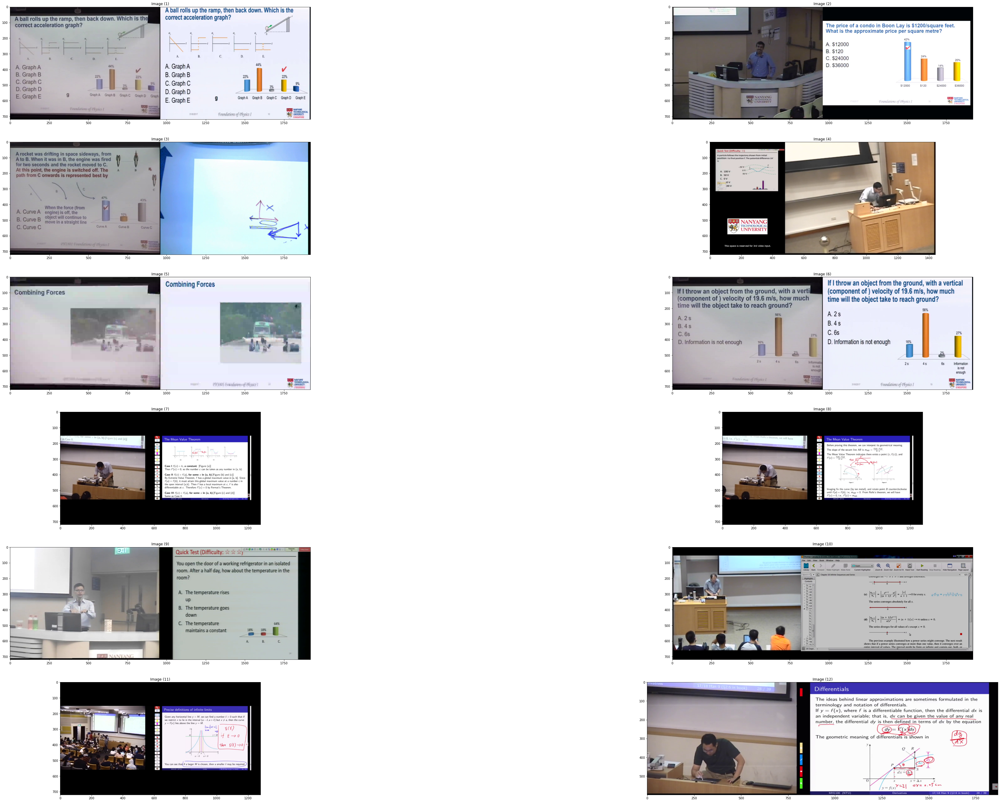

In [30]:
show_images(images=screenshots, cols=6)

## Check images

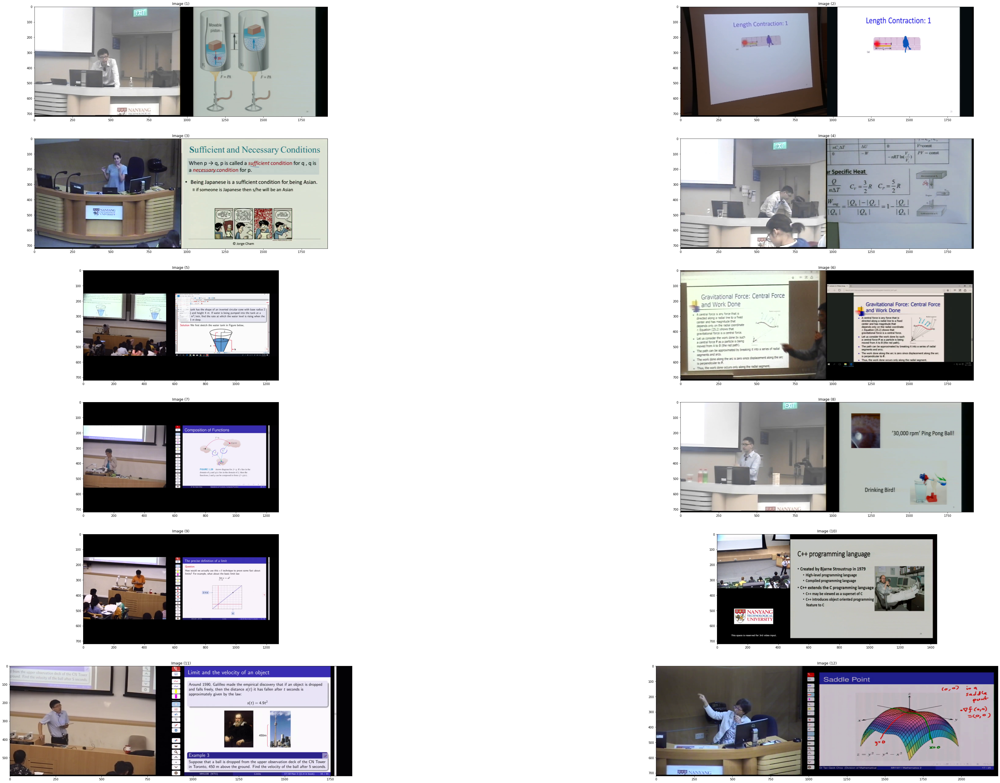

In [16]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_IMAGES_S, n=12)
show_images(images=screenshots, cols=6)

## Check websites

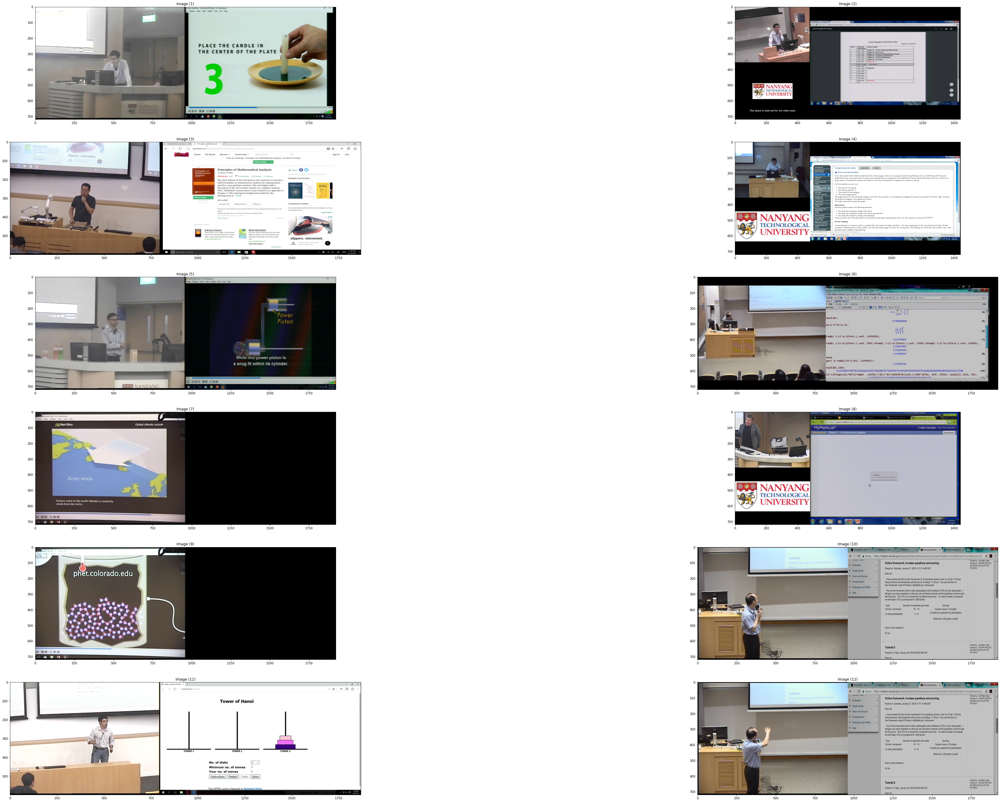

In [17]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_WEBSITE_S, n=12)
show_images(images=screenshots, cols=6)

## Check films

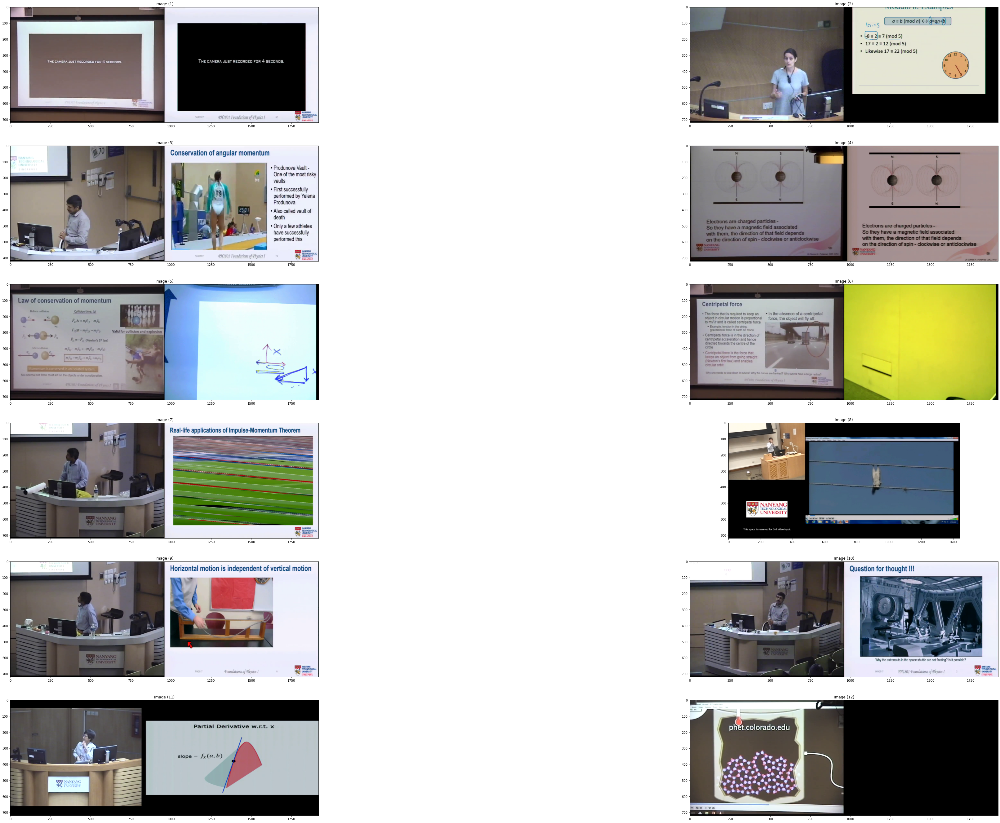

In [18]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_FILMS_S, n=12)
show_images(images=screenshots, cols=6)

## Check writing

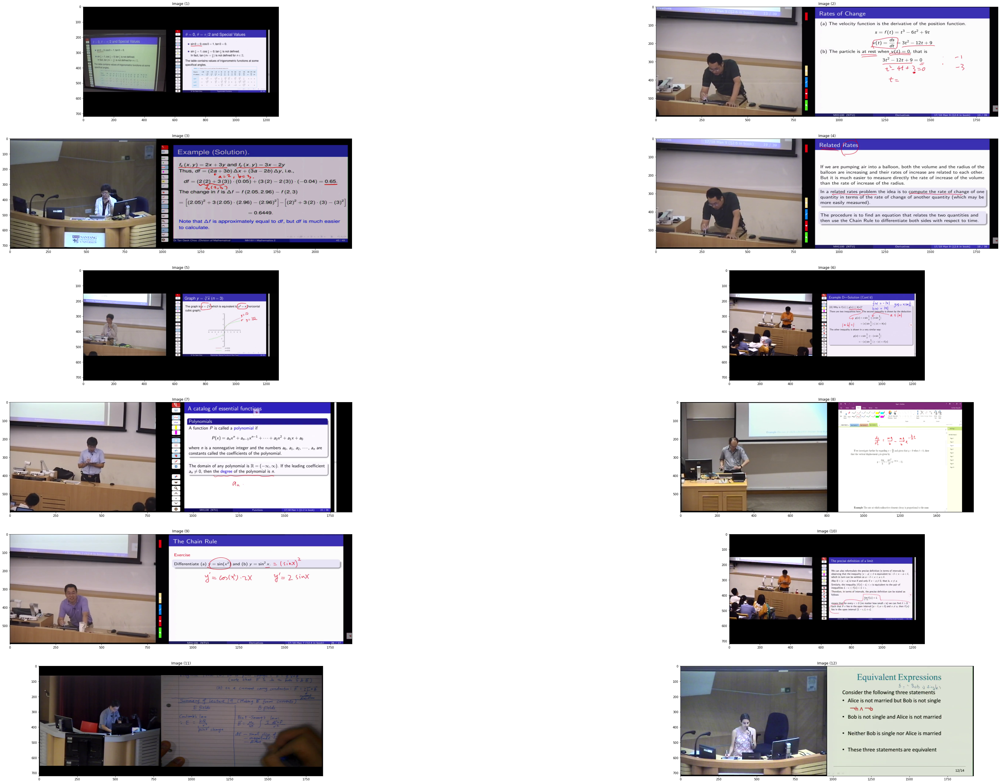

In [19]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_WRITING, n=12)
show_images(images=screenshots, cols=6)

## Check session on test

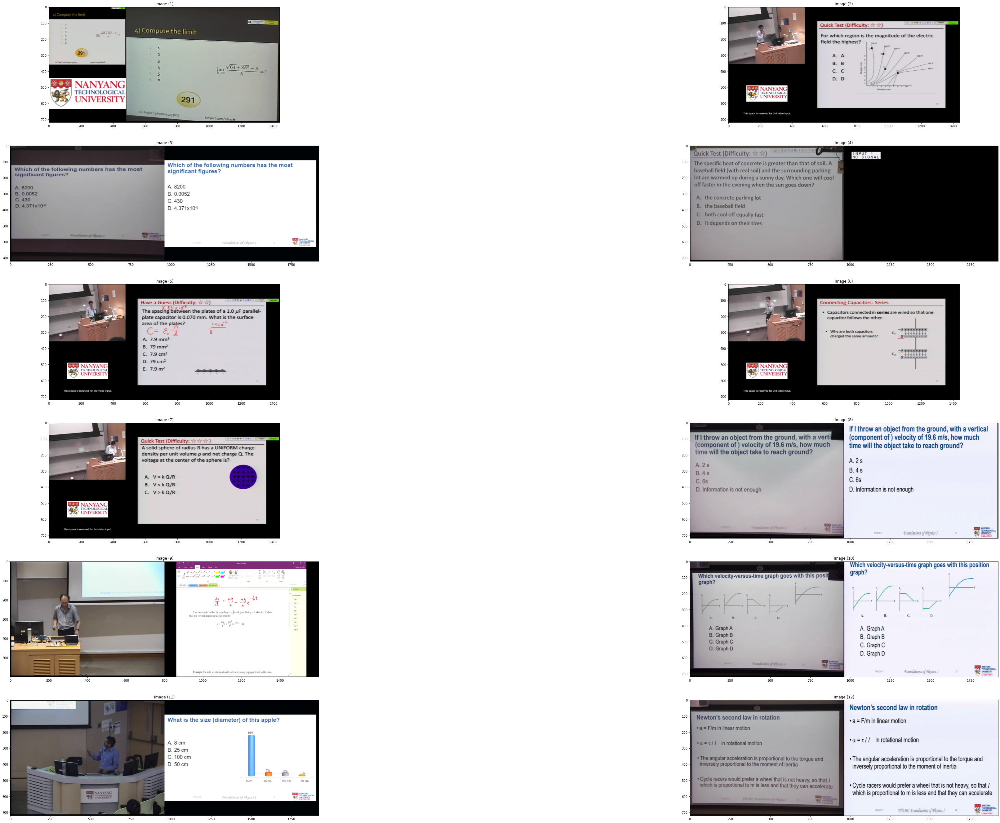

In [21]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_SESSIONS_S, n=12)
show_images(images=screenshots, cols=6)

## Check assignments

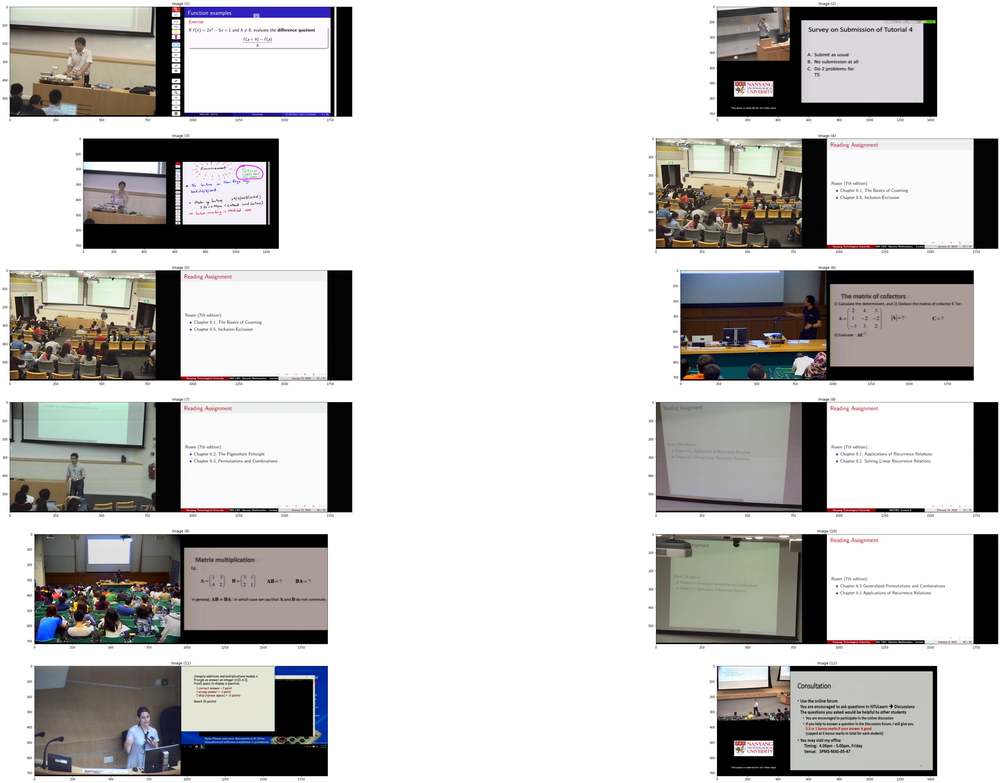

In [24]:
screenshots = make_n_random_behaviors_screenshots(behavior_id=C.B_ASSIGNMENTS, n=12)
show_images(images=screenshots, cols=6)